DSC160 Data Science and the Arts - Twomey - Spring 2020 - [dsc160.roberttwomey.com](http://dsc160.roberttwomey.com)

# Exercise 2: Audio Classification with MFCCs

This exercise walks you through feature extraction and genre classification based on MFCCs, using audio frames extracted from two instances of distinct audio styles (classical and rap music).

It has two parts:
- [Part 1](#Part-1:-Genre-Recognition). In this part you will load two audio files as genre examples, extract MFCC features from each, and implement a simple SVM classifier.
  - [Step 1 - Load Files and Display Audio](#Step-1:-Load-Files-and-Display-Audio)
  - [Step 2 - Extract Features](#Step-2:-Extract-Features)
  - [Step 3 - Train a Classifier](#Step-3:-Train-a-Classifier)
  - [Step 4 - Run the Classifier](#Step-4:-Run-the-Classifier)
- [Part 2](#Part-2:-Extension). In this part you will extend the work from Part 1, either creating a new classifier using new genre examples and training examples from your own music collection, implementing a new classifier method, or experimenting with different features for the SVM and existing examples.
  - [Part 2A - Code for your Extension](#2A.-Code-for-Extension)
  - [Part 2B - Discussion of Results](#2B.-Discussion-of-Results)
  
Once you have completed both parts, you will submit your completed notebook as a pdf to gradescope for grading.

Note: this is a simplified genre classification example. For a more comprehensive approach combining timbral, beat, and pitch features, see Tzanetakis and Cook ['Musical Genre Classification of Audio Signal'](https://pdfs.semanticscholar.org/4ccb/0d37c69200dc63d1f757eafb36ef4853c178.pdf) from IEEE Transactions on Audio and Speech Processing 2002. Many of the techniques described in that paper can be implemented using librosa and our numpy/scipy toolkits for your own Project 1.

## Setup

Import necessary modules:

In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import seaborn

import librosa
import librosa.display

from IPython.display import Audio

import requests
import os

import sklearn
import numpy as np

import pandas as pd

## Part 1: Genre Recognition
(50 points total)

This section walks you through three steps: 
1. Load and Display Audio Files
2. Extracting features from an audio signal.
3. Training a genre classifier.
4. Using the classifier to classify the genre in a song.

### Step 1: Load Files and Display Audio
(10 points)

We will use two audio pieces as exemplars of distinct audio genres:

- Johannes Brahms' ['Hungarian Dance #5 in G Minor'](https://www.youtube.com/watch?v=3X9LvC9WkkQ) (1885) 
- Busta Rhmyes' ['Hits for Days feat. J Holiday'](https://www.youtube.com/watch?v=B6bt3gWLV5g) (2016) 
  
These have both been added to the course repository in an `audio` subdirectory under the current path:
- `audio/brahms_hungarian_dance_5.mp3`
- `audio/busta_rhymes_hits_for_days.mp3`

Using [`librosa.load`](https://librosa.github.io/librosa/generated/librosa.core.load.html), load 120 seconds of Brahms :

In [2]:
# your code here
y_brahms, sr_brahms = librosa.load('brahms_hungarian_dance_5.mp3', duration=120)

Using `librosa.display.waveplot`, plot the time-domain waveform of the audio signal for Brahms:

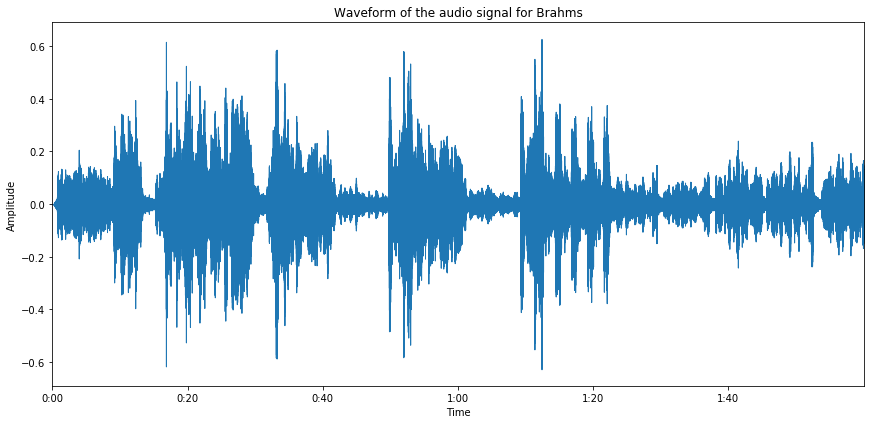

In [3]:
# your code here
plt.figure(figsize=(12,6))
librosa.display.waveplot(y_brahms, sr_brahms)
plt.title('Waveform of the audio signal for Brahms')
plt.tight_layout()
plt.ylabel('Amplitude')
plt.show()

Using the IPython.display Audio class, play the audio file:

In [4]:
# your code here
Audio(data=y_brahms, rate=sr_brahms)

Using [`librosa.feature.melspectogram`](https://librosa.github.io/librosa/generated/librosa.feature.melspectrogram.html), [`librosa.power_to_db`](https://librosa.github.io/librosa/generated/librosa.core.power_to_db.html), and [`librosa.display.specshow`](https://librosa.github.io/librosa/generated/librosa.display.specshow.html), calculate and display the mel spectogram with a logarithmic magnitude scale:

In [5]:
# calculate mel spectogram
melspec_brahms = librosa.feature.melspectrogram(y_brahms, sr_brahms)

# convert spectogram to log spectogram with power_to_db
scale_brahms = librosa.power_to_db(melspec_brahms)

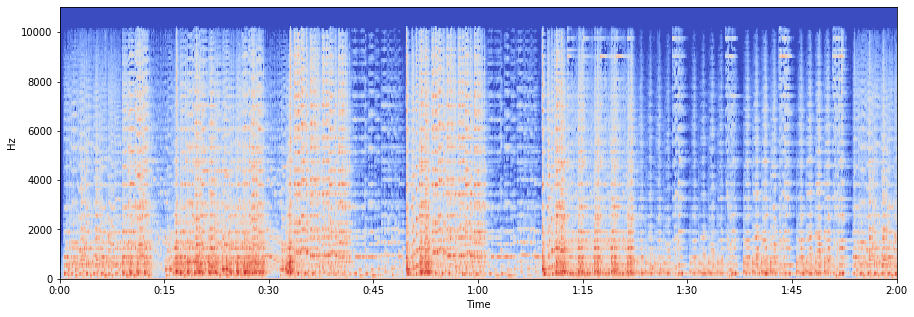

In [6]:
# show spectogram
plt.figure(figsize=(15,5))
librosa.display.specshow(scale_brahms, sr=sr_brahms, x_axis='time', y_axis='hz')
plt.show()

Repeat the above steps for the Busta Rhymes song. 

Load the file:

In [7]:
# your code here
y_busta, sr_busta = librosa.load('busta_rhymes_hits_for_days.mp3', duration=120)

Display the waveform:

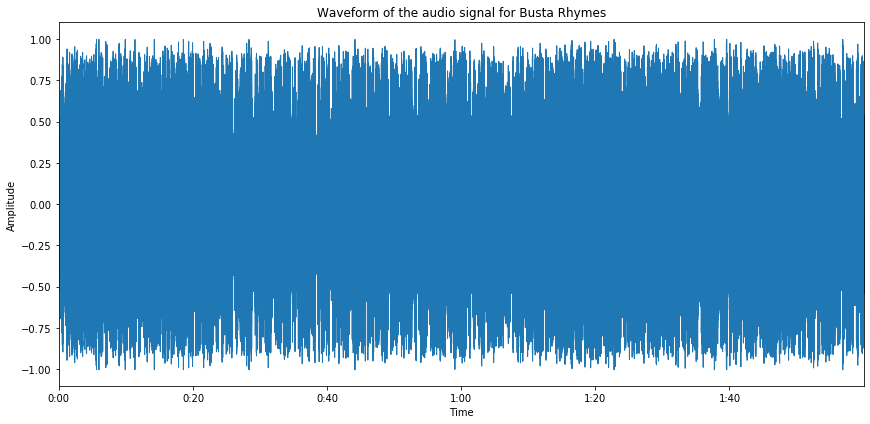

In [8]:
# your code here
plt.figure(figsize=(12,6))
librosa.display.waveplot(y_busta, sr_busta)
plt.title('Waveform of the audio signal for Busta Rhymes')
plt.tight_layout()
plt.ylabel('Amplitude')
plt.show()

Play the audio file:

In [9]:
# your code here
Audio(data=y_busta, rate=sr_busta)

Calculate and display the mel spectogram with a logarithmic magnitude scale:

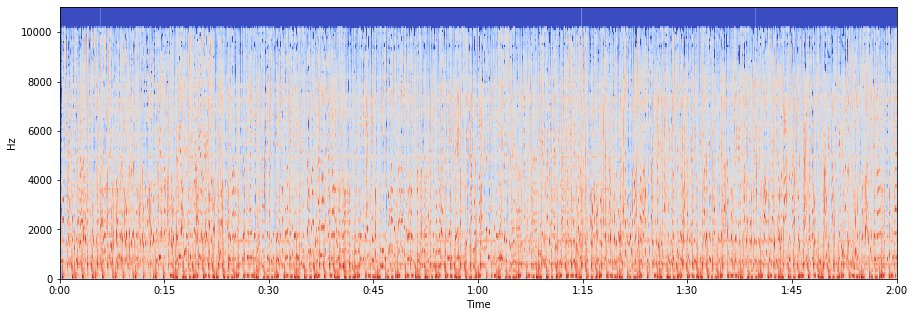

In [10]:
# calculate
melspec_busta = librosa.feature.melspectrogram(y_busta, sr_busta)
scale_busta = librosa.power_to_db(melspec_busta)

# display
plt.figure(figsize=(15,5))
librosa.display.specshow(scale_busta, sr=sr_busta, x_axis='time', y_axis='hz')
plt.show()

Do you notice any difference between the wave form or spectogram for the classical and rap song? Is so, what? 

```The amplitude in the wave form of classical music is generally smaller than the amplitude in rap song. Also, some intervals of time in classical music have obvious larger amplitudes than in other time, while the rap song have similar amplitude throughout the audio. In spectrogram, some specific intervals of time have higher frequency activities while other intervals do not; however, the rap song has some dominant low frequencies throughout the song.```

### Step 2: Extract Features

(10 points)

We are going to work with MFCCs. For each of your audio files (starting with Brahms), use [`librosa.feature.mfcc`](https://librosa.github.io/librosa/generated/librosa.feature.mfcc.html) to calculate the MFCCs.

(Note: you can experiment with `n_mfcc` to select a different number of coefficients, e.g. 12)

Start with Brahms, using 12 coefficients, inputting the Brahms time series and Brahms sample rate as the arguments to the mfcc function.

In [11]:
# your code here
mfcc_brahms = librosa.feature.mfcc(y_brahms, sr=sr_brahms, n_mfcc=12)

Note: We transpose the result to accommodate scikit-learn which assumes that each row is one observation, and each column is one feature dimension:

In [12]:
mfcc_brahms = mfcc_brahms.T
mfcc_brahms.shape

(5168, 12)

Using [`sklearn.preprocessing.StandardScaler`](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html), scale the features to have zero mean and unit variance:

In [13]:
# your code here
standardize = sklearn.preprocessing.StandardScaler()
mfcc_brahms_scaled = standardize.fit_transform(mfcc_brahms)

Verify that the scaling worked (e.g. do we have a mean close to zero and std deviation close to 1 for each feature?):

In [14]:
mfcc_brahms_scaled.mean(axis=0)

array([ 2.56372795e-15,  1.68473981e-14,  6.71290992e-16,  4.07310924e-17,
       -1.48213055e-15, -6.81259744e-15, -2.22704122e-15, -8.73081492e-16,
        3.34141040e-16, -1.90830324e-16,  2.74505221e-16, -9.32346735e-18])

In [15]:
mfcc_brahms_scaled.std(axis=0)

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

Repeat these calculations for Busta Rhymes. Use [`librosa.feature.mfcc`](https://librosa.github.io/librosa/generated/librosa.feature.mfcc.html) to calculate the MFCCs, inputting the Busta time series and Busta sample rate as the arguments to the mfcc function.

In [16]:
# your code here
mfcc_busta = librosa.feature.mfcc(y_busta, sr_busta, n_mfcc=12)

Note: Transpose the result to accommodate scikit-learn which assumes that each row is one observation, and each column is one feature dimension:

In [17]:
mfcc_busta = mfcc_busta.T
mfcc_busta.shape

(5168, 12)

Scale the resulting MFCC features to have approximately zero mean and unit variance. Re-use the scaler from above.

In [18]:
# your code here
mfcc_busta_scaled = standardize.fit_transform(mfcc_busta)

Verify that the mean of the MFCCs for the second audio file is approximately equal to zero and the variance is approximately equal to one.

In [19]:
mfcc_busta_scaled.mean(axis=0)

array([-1.42924028e-15,  4.04698634e-15, -4.07667536e-15,  1.96785313e-15,
        4.43451175e-15, -4.45164416e-15, -8.36942315e-16, -3.48298169e-15,
       -2.49381269e-15, -2.52657372e-15, -7.88047818e-16,  2.45813002e-15])

In [20]:
mfcc_busta_scaled.std(axis=0)

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

### Step 3: Train a Classifier

(15 points)

Concatenate all of the scaled feature vectors into one feature table using [`np.vstack`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.vstack.html).

In [21]:
# your code here
features = np.vstack((mfcc_brahms_scaled, mfcc_busta_scaled))

In [22]:
features.shape

(10336, 12)

Construct a vector of ground-truth labels using [`np.concatenate`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.concatenate.html), where 0 refers to the first audio file, and 1 refers to the second audio file. (use `np.zeros` and `np.ones` for brahms and busta rhymes)

In [23]:
labels = np.concatenate((np.zeros(len(mfcc_brahms_scaled)), np.ones(len(mfcc_busta_scaled))))

Create a classifer model object using sklearn's Support Vector Machine [`sklearn.svm.SVC`](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html):

In [24]:
# Support Vector Machine
model = sklearn.svm.SVC()

Train the classifier with your test data and labels using [`SVC.fit`](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html#sklearn.svm.SVC.fit):

In [25]:
# your code here
model.fit(features, labels)

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
    kernel='rbf', max_iter=-1, probability=False, random_state=None,
    shrinking=True, tol=0.001, verbose=False)

### Step 4: Run the Classifier

(15 points)

To test the classifier, we will extract an unused 10-second segment from the earlier audio fields as test excerpts:

In [26]:
filename_brahms = 'brahms_hungarian_dance_5.mp3'
x_brahms_test, fs_brahms = librosa.load(filename_brahms, duration=10, offset=120)

In [27]:
filename_busta = 'busta_rhymes_hits_for_days.mp3'
x_busta_test, fs_busta = librosa.load(filename_busta, duration=10, offset=120)

Display the waveform and listen to the audio for both of the test excerpts using `librosa.display.waveplot` and 
`Audio`. 

Start with Brahms test (wave plot and audio player):

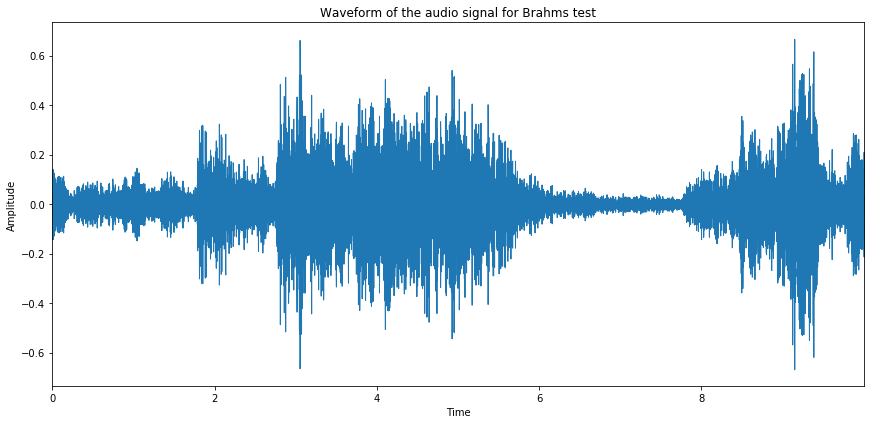

In [28]:
# wave plot
plt.figure(figsize=(12, 6))
librosa.display.waveplot(x_brahms_test, fs_brahms)
plt.title('Waveform of the audio signal for Brahms test')
plt.tight_layout()
plt.ylabel('Amplitude')
plt.show()

# audio playback
Audio(data=x_brahms_test, rate=fs_brahms)

Next Busta test (waveplot and audio player):

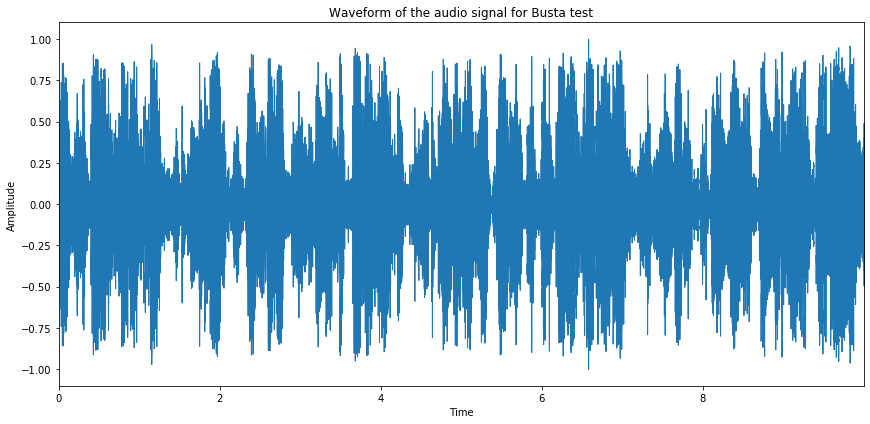

In [29]:
# wave plot
plt.figure(figsize=(12, 6))
librosa.display.waveplot(x_busta_test, fs_busta)
plt.title('Waveform of the audio signal for Busta test')
plt.tight_layout()
plt.ylabel('Amplitude')
plt.show()

# audio playback
Audio(data=x_busta_test, rate=fs_busta)

Compute MFCCs from both of the test audio excerpts folowing above using `librosa.feature.mfcc`:

In [30]:
# calculate brahms test mfccs
mfcc_brahms_test = librosa.feature.mfcc(x_brahms_test, sr=fs_brahms, n_mfcc=12)
mfcc_brahms_test = mfcc_brahms_test.T

In [31]:
# calculate busta rhymes test mfccs
mfcc_busta_test = librosa.feature.mfcc(x_busta_test, sr=fs_busta, n_mfcc=12)
mfcc_busta_test = mfcc_busta_test.T

Scale the test sample MFCCs using the previous scaler:

In [32]:
# your code here
mfcc_busta_test_scaled = standardize.fit_transform(mfcc_busta_test)
mfcc_busta_test_scaled.shape

(431, 12)

In [33]:
# your code here
mfcc_brahms_test_scaled = standardize.fit_transform(mfcc_brahms_test)
mfcc_brahms_test_scaled.shape

(431, 12)

Concatenate all test features together using `np.vstack`:

In [34]:
test_features = np.vstack((mfcc_brahms_test_scaled, mfcc_busta_test_scaled))

Concatenate all test labels together (using `np.concatenate`, with `np.zeros` for brahms and `np.ones` for busta rhymes):

In [35]:
test_labels = np.concatenate((np.zeros(len(mfcc_brahms_test_scaled)), np.ones(len(mfcc_busta_test_scaled))))

Compute the predicted labels using `model.predict`:

In [36]:
model.predict(test_features)

array([1., 1., 0., 1., 0., 0., 0., 0., 1., 1., 1., 1., 1., 0., 0., 0., 0.,
       0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 0., 1., 1., 1., 1., 1., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0.

Finally, compute the accuracy score of the classifier on the test data using `model.score`, based on predicted labels and test labels:

In [37]:
# your code here
svm_score = model.score(test_features, test_labels)
svm_score

0.9025522041763341

Do you believe this classifier is performing well? If so, why? If not, why not?

```According to the sklearn document, the score method will return the mean accuracy on the given test data and labels. Our model's score on the test features and labels is 0.902 which does fit well. However, since the train and test dataset come from the two same songs respectively, this classifier does not guarantee that it can generalize on other classical/rap music to predict their genre.```

## Part 2: Extension
(50 points)

Extend this exercise in some aspect. Possible extension include:
- Find a confounding example (hip hop song that samples classical music), calculate and classify MFCCs. What do you find are the classification results? Plot the label over time.
- Create a new genre classifier by repeating the steps above, but this time use training data and test data from your own audio collection representing two or more different genres. For what genres and audio data styles does the classifier work well, and for which (pairs of) genres does the classifier fail?
- Create a new genre classifier by repeating the steps above, but this time use a different machine learning classifier, e.g. random forest, Gaussian mixture model, Naive Bayes, k-nearest neighbor, etc. Adjust the parameters. How well do they perform?
- Create a new genre classifier by repeating the steps above, but this time use different features. Consult the [librosa documentation on feature extraction](http://librosa.github.io/librosa/feature.html) for different choices of features. Which features work well? not well?

### 2A. Code for Extension

Write your code below with comments (25 points): 

#### Step 1: load files and display audio

In [38]:
# load the train datasets from two audios
brahms_filename = 'brahms_hungarian_dance_5.mp3'
busta_filename = 'busta_rhymes_hits_for_days.mp3'

# extract 120s from both audios
x_brahms_train, sr_brahms_train = librosa.load(brahms_filename, duration=120)
x_busta_train, sr_busta_train = librosa.load(busta_filename, duration=120)

In [39]:
# display the audio from Brahms music
Audio(x_brahms_train, rate=sr_brahms_train)

In [40]:
# display the audio from Busta song
Audio(x_busta_train, rate=sr_busta_train)

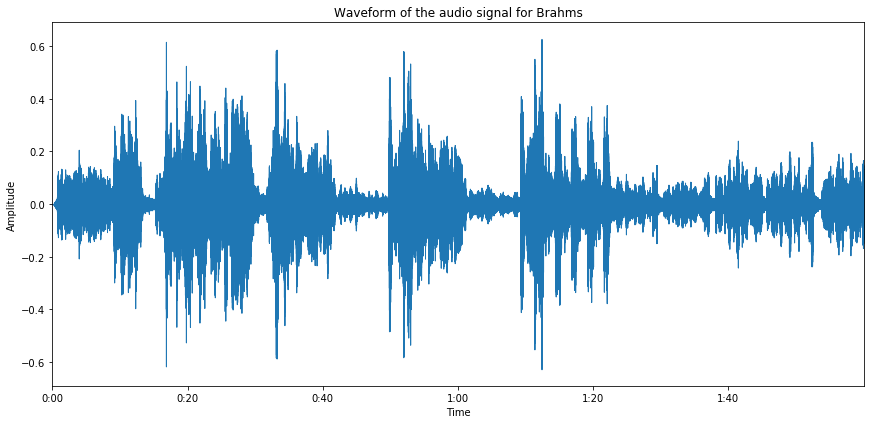

In [41]:
# display the waveform of Brahms song
plt.figure(figsize=(12,6))
librosa.display.waveplot(x_brahms_train, sr_brahms_train)
plt.title('Waveform of the audio signal for Brahms')
plt.tight_layout()
plt.ylabel('Amplitude')
plt.show()

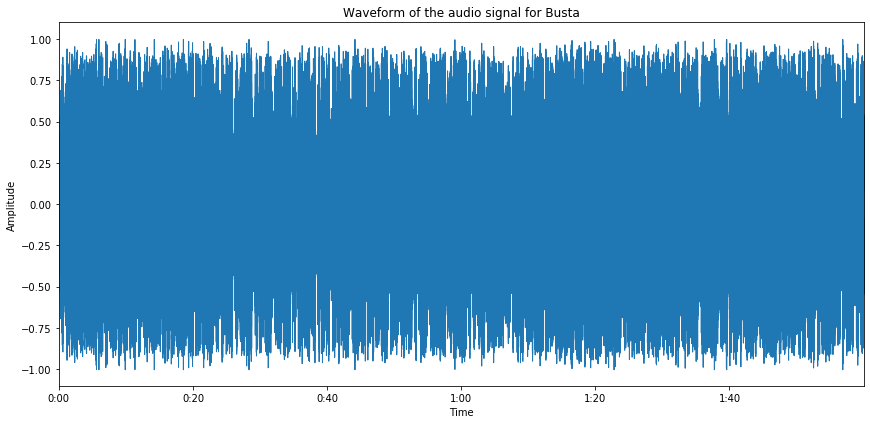

In [42]:
# display the waveform of Busta song
plt.figure(figsize=(12,6))
librosa.display.waveplot(x_busta_train, sr_busta_train)
plt.title('Waveform of the audio signal for Busta')
plt.tight_layout()
plt.ylabel('Amplitude')
plt.show()

In [43]:
# calculate the mel spectrogram for both audios
melspec_brahms_train = librosa.feature.melspectrogram(x_brahms_train, sr_brahms_train)
melspec_busta_train = librosa.feature.melspectrogram(x_busta_train, sr_busta_train)

# convert the spectrograms to log spectrogram with power_to_db
logmel_brahms_train = librosa.power_to_db(melspec_brahms_train)
logmel_busta_train = librosa.power_to_db(melspec_busta_train)

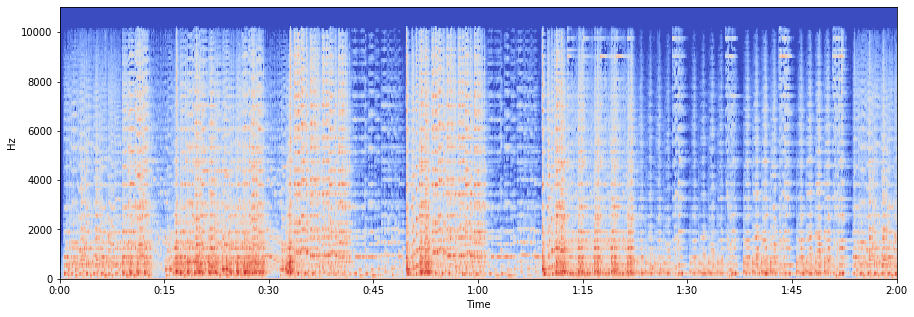

In [44]:
# show the spectrogram for Brahms
plt.figure(figsize=(15,5))
librosa.display.specshow(logmel_brahms_train, sr=sr_brahms_train, x_axis='time', y_axis='hz')
plt.show()

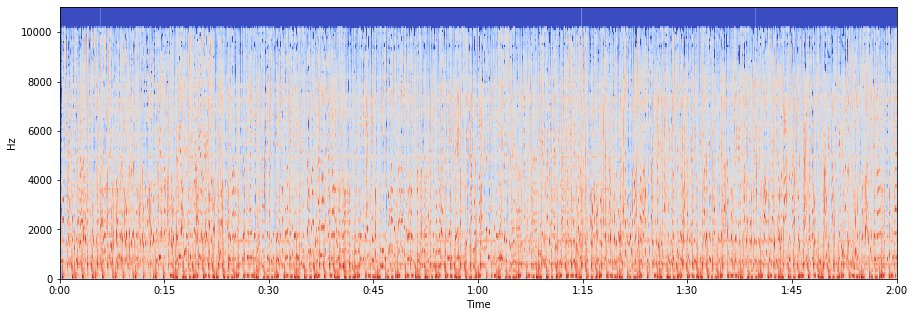

In [45]:
# show the spectrogram for Busta
plt.figure(figsize=(15,5))
librosa.display.specshow(logmel_busta_train, sr=sr_busta_train, x_axis='time', y_axis='hz')
plt.show()

#### Step 2: extract features

In [46]:
# extract MFCC from both audios by choosing 12 coefficients
n_mfcc = 12
mfcc_brahms_train = librosa.feature.mfcc(x_brahms_train, sr=sr_brahms_train, n_mfcc=n_mfcc).T
mfcc_busta_train = librosa.feature.mfcc(x_busta_train, sr=sr_busta_train, n_mfcc=n_mfcc).T

In [47]:
# use sklearn to standardize the features
scaler = sklearn.preprocessing.StandardScaler()
mfcc_brahms_train_scaled = scaler.fit_transform(mfcc_brahms_train)
mfcc_busta_train_scaled = scaler.fit_transform(mfcc_busta_train)

#### Step 3: Train a Classifier

In [48]:
# concatenate all of the scaled fature vectors into one feature table
features = np.vstack((mfcc_brahms_train_scaled, mfcc_busta_train_scaled))

# construct a vector for labels
# 0 for Brahms and 1 for Busta
labels = np.concatenate((np.zeros(len(mfcc_brahms_train_scaled)), np.ones(len(mfcc_busta_train_scaled))))

In [49]:
# create a classfier model by using KNN neighbor
knn = sklearn.neighbors.KNeighborsClassifier()

# use grid search to select best hyper-parameters
param_grid = {'n_neighbors': [3,4,5,6,7], 'leaf_size':[3,4,5,6,7], 'weights':['uniform', 'distance']}
grid = sklearn.model_selection.GridSearchCV(knn, param_grid, scoring='accuracy', n_jobs=-1, cv=5) 
grid.fit(features, labels)

# print the best params
print(grid.best_score_)
print(grid.best_params_)

0.8828366873065016
{'leaf_size': 3, 'n_neighbors': 6, 'weights': 'distance'}


In [50]:
# using the best hyper-params chose by grid search to create the model
model_knn = sklearn.neighbors.KNeighborsClassifier(leaf_size = 3, n_neighbors = 6, weights='distance')

# fit the train data
model_knn.fit(features, labels)

KNeighborsClassifier(algorithm='auto', leaf_size=3, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=6, p=2,
                     weights='distance')

#### Step 4: run the classfier

In [51]:
# extract the unseen 10-second segments from both audios
x_brahms_test, fs_brahms = librosa.load(brahms_filename, duration=10, offset=120)
x_busta_test, fs_busta = librosa.load(busta_filename, duration=10, offset=120)

# compute the MFCCs from both test data
mfcc_brahms_test = librosa.feature.mfcc(x_brahms_test, sr=fs_brahms, n_mfcc=12).T
mfcc_busta_test = librosa.feature.mfcc(x_busta_test, sr=fs_busta, n_mfcc=12).T

# standardize the feature vectors
mfcc_brahms_test_scaled = scaler.fit_transform(mfcc_brahms_test)
mfcc_busta_test_scaled = scaler.fit_transform(mfcc_busta_test)

In [52]:
# concatenate the test features
test_features = np.vstack((mfcc_brahms_test_scaled, mfcc_busta_test_scaled))

# create the test labels
test_labels = np.concatenate((np.zeros(len(mfcc_brahms_test_scaled)), np.ones(len(mfcc_busta_test_scaled))))

In [53]:
# compute the accuracy score on the test data
model_knn.predict(test_features)
knn_score = model_knn.score(test_features, test_labels)
knn_score

0.8990719257540604

#### Step 5: using other classifiers to predict

1) use Gaussian Naive Bayes to predict labels:

In [54]:
# create a Naive Bayes model by using sklearn
from sklearn.naive_bayes import GaussianNB
model_gaussian = GaussianNB()
model_gaussian.fit(features,labels)
# show the score of the model
gaussian_score = model_gaussian.score(test_features, test_labels)
gaussian_score

0.5081206496519721

2) use Random Forest to predict labels:

In [55]:
# create a classfier model by using KNN neighbor
from sklearn.ensemble import RandomForestClassifier
random_forest = RandomForestClassifier()

# use grid search to select best hyper-parameters
param_grid = {
    'n_estimators':[100, 200, 300],
    'max_depth': [8, 9, 10, 11, 12],
    'random_state': [0]
}
grid = sklearn.model_selection.GridSearchCV(random_forest, param_grid, scoring='accuracy', n_jobs=-1, cv=5) 
grid.fit(features, labels)

# print the best params
print(grid.best_score_)
print(grid.best_params_)

0.8812886996904025
{'max_depth': 12, 'n_estimators': 200, 'random_state': 0}


In [56]:
# use the best hyper-param to predict
model_randomf = RandomForestClassifier(n_estimators=200, max_depth=12, random_state=0)
model_randomf.fit(features, labels)
# show the score of the model
randomf_score = model_randomf.score(test_features, test_labels)
randomf_score

0.8607888631090487

### 2B. Discussion of Results

(25 points total)

Describe your goals for the extension (1 paragraph, 10 points):

```In the extension part, I have created several different and new genre classifiers by repeating the steps in part 1. These new machine learning classifiers include: random forest, Gaussian Naive Bayes, and k-nearest neighbors (KNNs). For each classifier, I have used grid search to select the hyper-parameters which produce the best prediction score on the train datasets(except for the Gaussian Naive Bayes since it calculates the probabilites of each sample). Therefore, the goal is to compare the performance of each model on the test data by calculating their score(mean accuracy) in order to select the best machine learning model for classifying the genre of music.``` 

Describe your results for the extension (1 paragraph, 10 points):

```The scores of four machine learning models which predicted on the test data are shown below. The performances of SVM and KNN models are the best which score around 90% average accuracy. The score of random forest model is close to the former models which has around 86% accuracy. The Gaussian Naive Bayes obtain the lowest score which is around 50% accuracy. The inaccuracy of gaussian naive bayes might be caused by the simple assumption that assumes each feature is independent from the others, which is not applicable in our case. It is clear that both SVM and KNN models fit well on the provided data from two audios. I suppose that these two models are powerful in clustering samples thus useful in this binary classification problem. In conclusion, SVM, KNN and Random Forest all have an acceptable accuracy on predicting the labels of data. ```

In [57]:
print('SVM:', svm_score)
print('KNN:', knn_score)
print('Gaussian Naive Bayes:', gaussian_score)
print('Random Forest:', randomf_score)

SVM: 0.9025522041763341
KNN: 0.8990719257540604
Gaussian Naive Bayes: 0.5081206496519721
Random Forest: 0.8607888631090487


Describe future directions and interesting research questions for this line of inquiry (1 paragraph, 5 points):

```This comparative study in extension shows that there are three machine learning models which have reasonable classification accuracy in order to predict the genre of music. By computing the MFCC features from the provided audios these models efficiently classify the labels of two classes(classical and rap music). For future work, I am interested in investigating more about using different machine learning methods to predict the genres of music when the labels are not binary but multiple classes. In addition, it will be also interesting to use these models for classifying if we extract the features in different ways. ```

## References
- Tzanetakis and Cook ['Musical Genre Classification of Audio Signals'](https://pdfs.semanticscholar.org/4ccb/0d37c69200dc63d1f757eafb36ef4853c178.pdf) from IEEE Transactions on Audio and Speech Processing 2002.- International Society for Music Information Retrieval (ISMIR) [https://ismir.net/](https://ismir.net/)
- LibROSA [https://librosa.github.io/librosa/](https://librosa.github.io/librosa/)
- SciPy 2015 Talk on Audio / MIR: https://www.youtube.com/watch?v=MhOdbtPhbLU
  - [website](https://bmcfee.github.io/) [paper](https://bmcfee.github.io/papers/scipy2015_librosa.pdf)
- Music Representation: https://musicinformationretrieval.com/audio_representation.html
